<a href="https://colab.research.google.com/github/josejulianhidayat/Pengolahan_Citra_Digital/blob/main/03_Transformasi_Geometri_Suatu_Citra.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Transformasi Geometri pada Citra Digital**

# Scaling (Perubahan Ukuran)

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
# Membaca gambar
image = cv2.imread('Jeruk_Mandarin.jpg')

In [ ]:
# Scaling dengan faktor 2x
scaled = cv2.resize(image, None, fx=2, fy=2, interpolation=cv2.INTER_LINEAR)

# Scaling ke ukuran spesifik (200x200)
scaled_fixed = cv2.resize(image, (200, 200), interpolation=cv2.INTER_AREA)

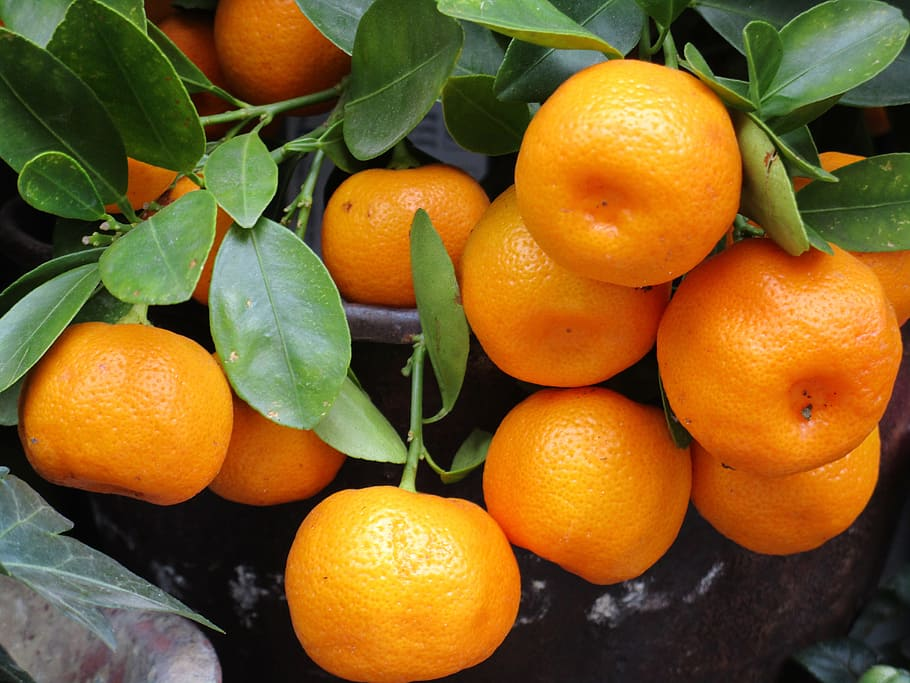

In [ ]:
# Menampilkan hasil
cv2_imshow(image)        # Gambar Asli

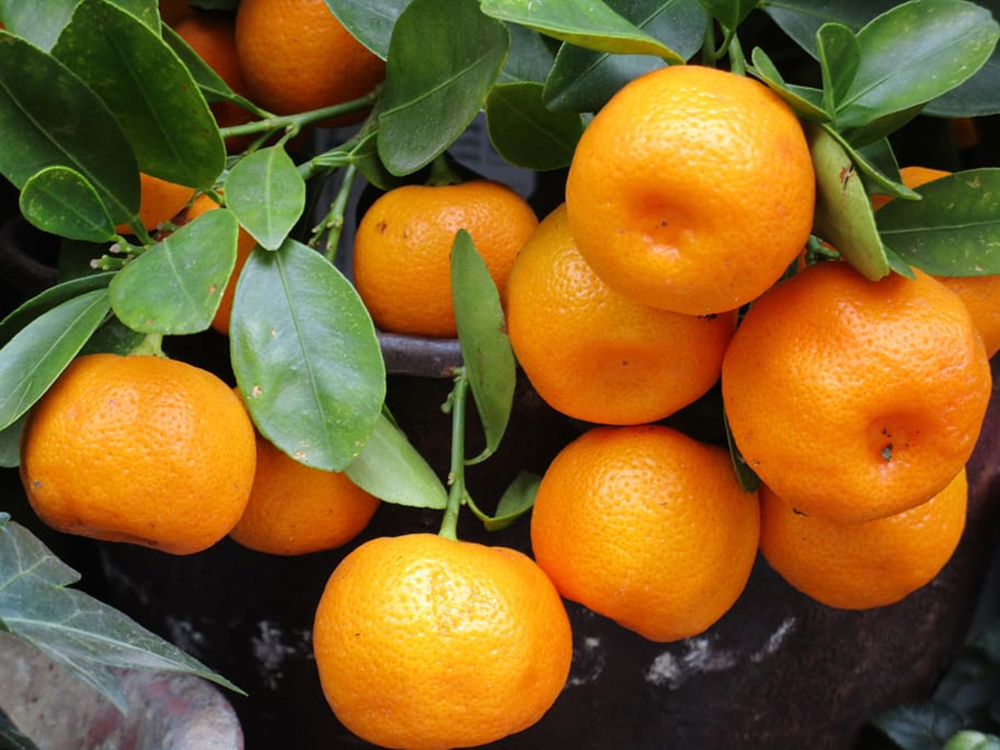

In [ ]:
cv2_imshow(scaled)       # Scaling 2x

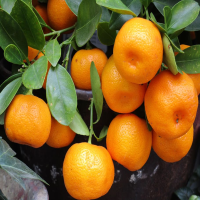

In [ ]:
cv2_imshow(scaled_fixed) # Scaling ke ukuran 200x200

🔹 Parameter fx dan fy menentukan faktor skala gambar.

🔹 Interpolasi digunakan untuk memperhalus perubahan ukuran (cv2.INTER_LINEAR, cv2.INTER_CUBIC, dll.).

# Rotasi (Perputaran Gambar)

In [ ]:
# Mendapatkan ukuran gambar
(h, w) = image.shape[:2]
center = (w // 2, h // 2)

In [ ]:
# Membuat matriks rotasi (Putar 45 derajat)
M = cv2.getRotationMatrix2D(center, 45, 1.0)
rotated = cv2.warpAffine(image, M, (w, h))

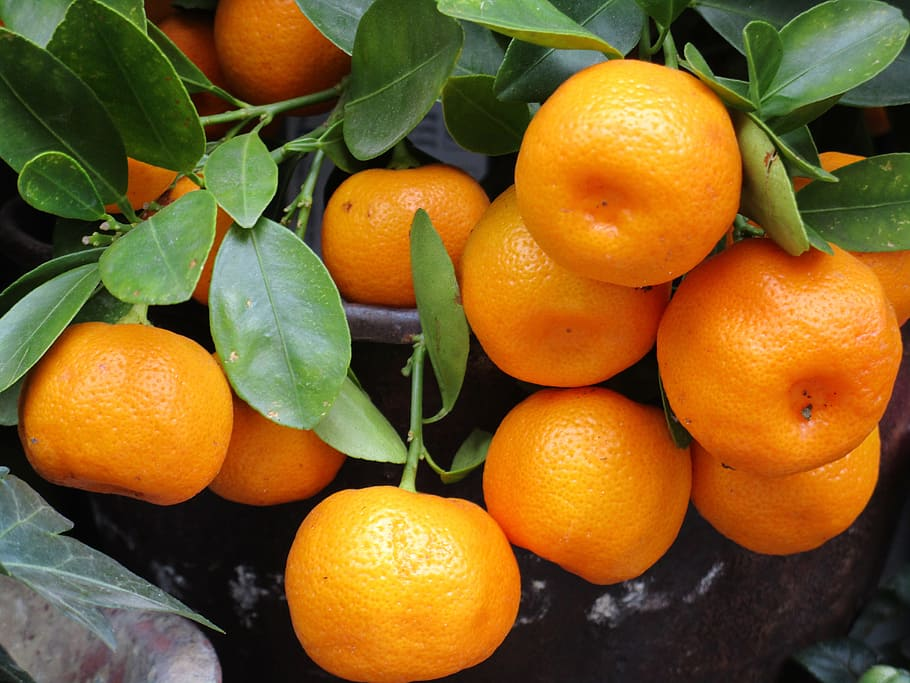

In [ ]:
cv2_imshow(image)   # Gambar Asli

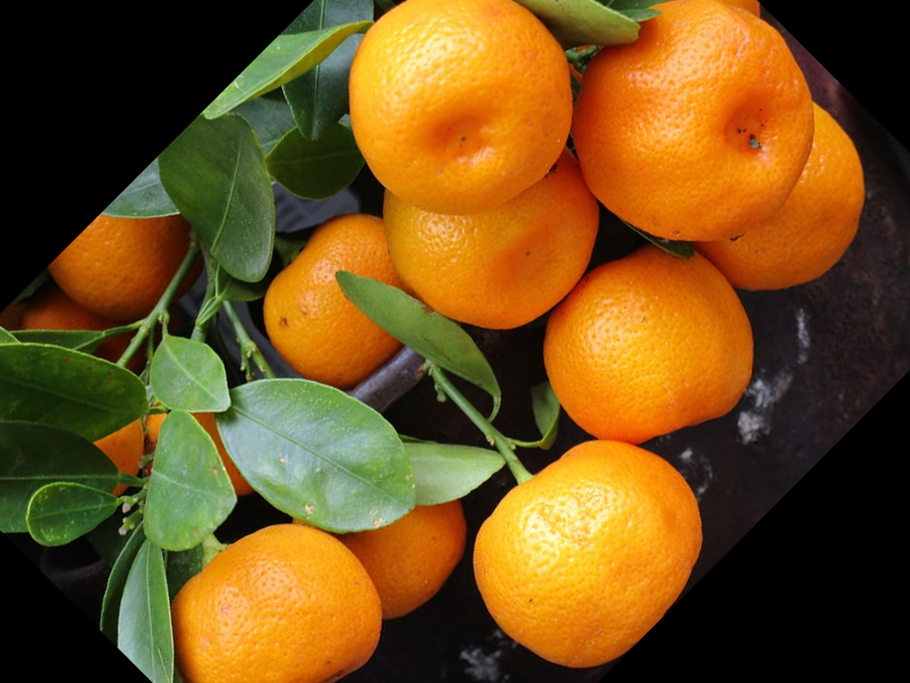

In [ ]:
cv2_imshow(rotated) # Gambar setelah rotasi 45 derajat

🔹 cv2.getRotationMatrix2D(center, angle, scale) → Membuat matriks rotasi.

🔹 cv2.warpAffine(image, M, (w, h)) → Menerapkan rotasi pada gambar.

#  Translasi (Pergeseran Gambar)

In [ ]:
import numpy as np

# Matriks translasi (Geser 100 piksel ke kanan, 50 ke bawah)
M = np.float32([[1, 0, 100], [0, 1, 50]])

# Menerapkan translasi
translated = cv2.warpAffine(image, M, (w, h))


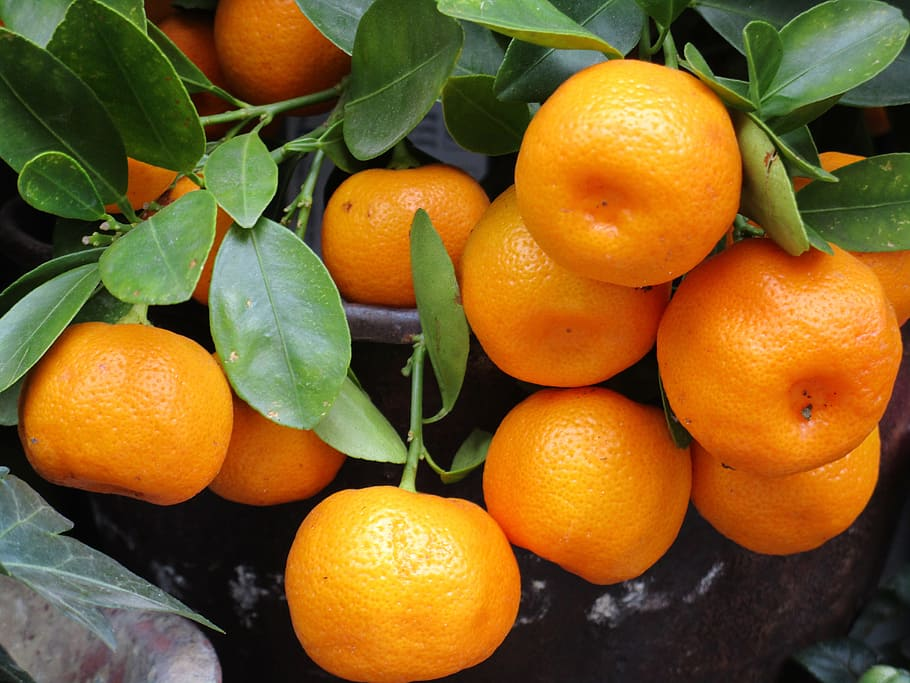

In [ ]:
# Menampilkan hasil
cv2_imshow(image)      # Gambar Asli

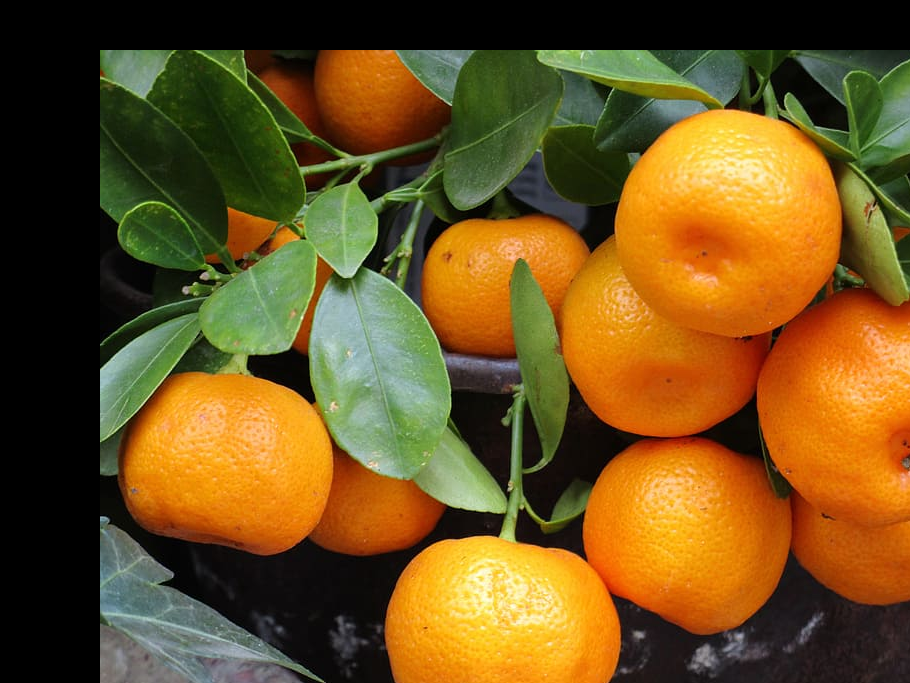

In [ ]:
cv2_imshow(translated) # Gambar setelah translasi

🔹 Matriks Translasi [ [1, 0, shift_x], [0, 1, shift_y] ] digunakan untuk menentukan arah pergeseran.

🔹 cv2.warpAffine() menerapkan translasi pada gambar.



# Flipping (Pencerminan Gambar)

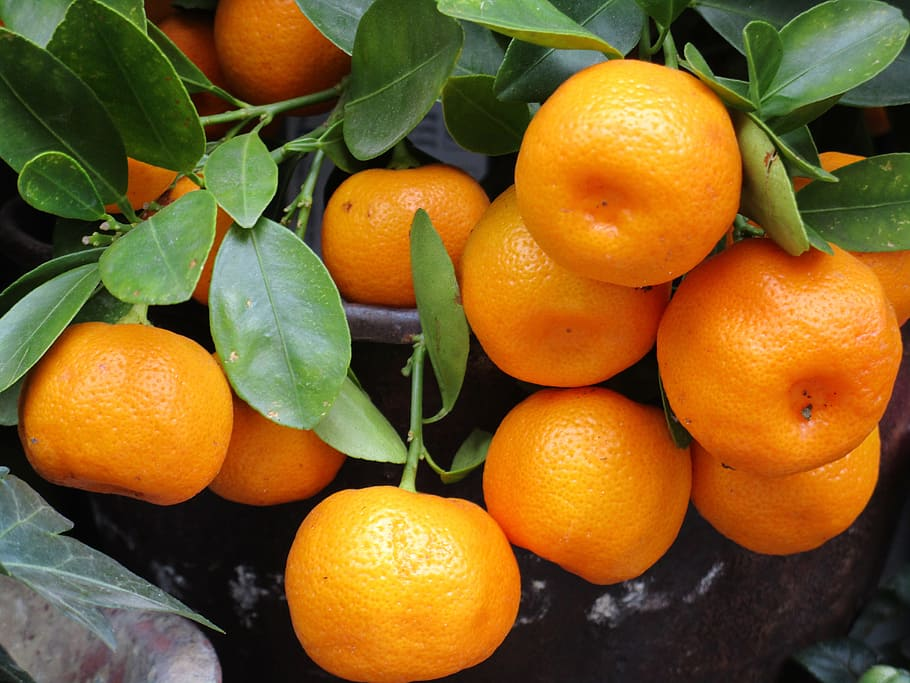

In [ ]:

cv2_imshow(image)       # Gambar Asli

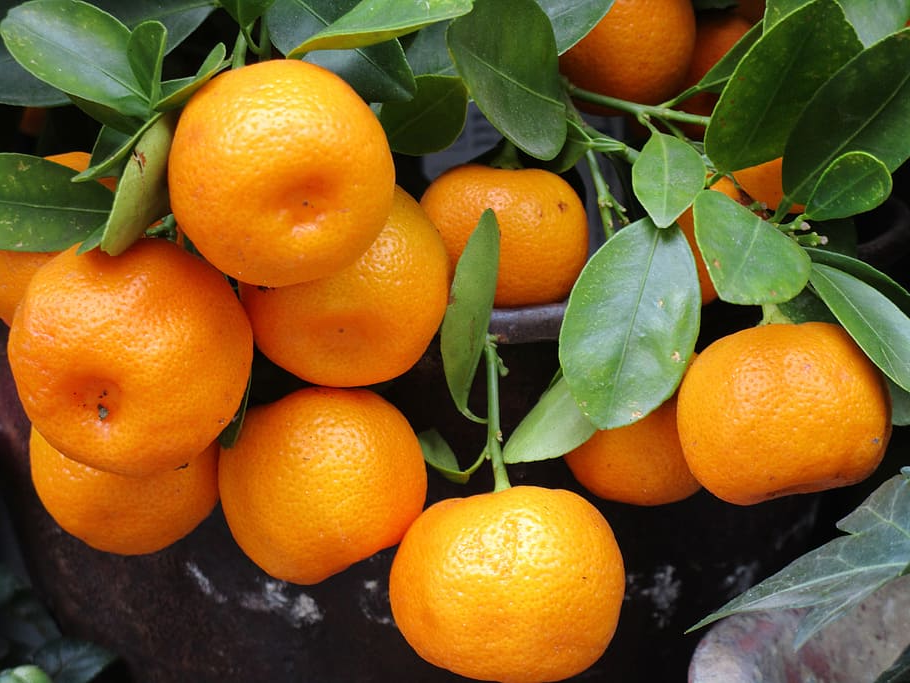

In [ ]:
# Flip horizontal
flip_hor = cv2.flip(image, 1)
cv2_imshow(flip_hor)    # Flip Horizontal

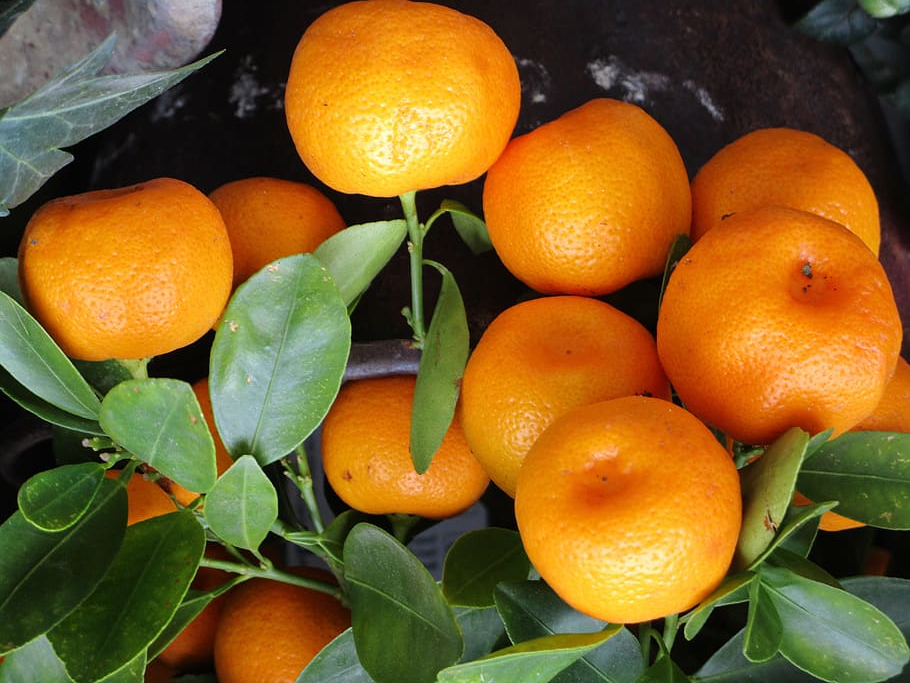

In [ ]:
# Flip vertikal
flip_ver = cv2.flip(image, 0)
cv2_imshow(flip_ver)    # Flip Vertikal

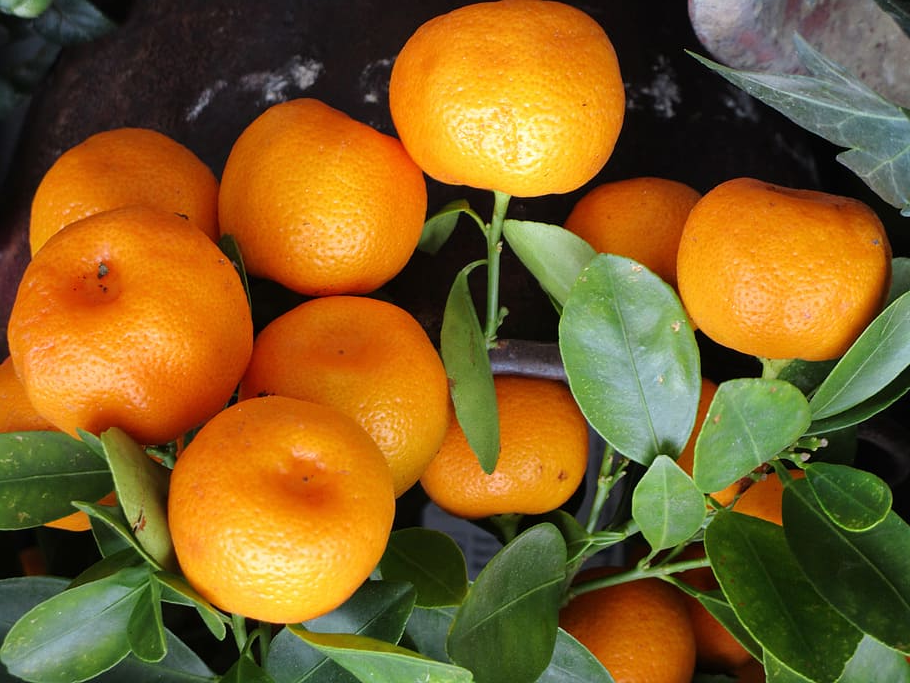

In [ ]:
# Flip horizontal dan vertikal
flip_both = cv2.flip(image, -1)

cv2_imshow(flip_both)   # Flip Horizontal dan Vertikal

#  Cropping (Pemotongan Gambar)

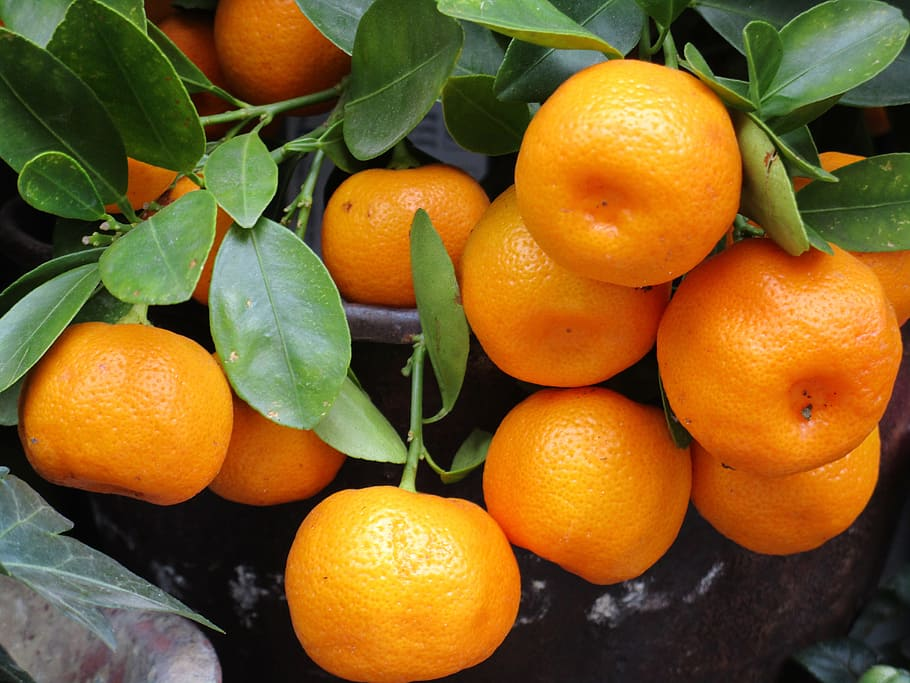

In [ ]:
# Crop area dari (y1:y2, x1:x2)
cropped = image[50:200, 100:300]

# Menampilkan hasil
cv2_imshow(image)     # Gambar Asli


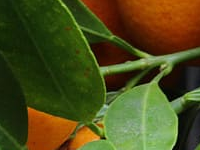

In [ ]:

cv2_imshow(cropped)   # Gambar setelah cropping


# Transformasi Afine

Transformasi Afine menjaga garis tetap paralel saat dilakukan transformasi.

In [ ]:
# Menentukan tiga titik sebelum dan sesudah transformasi
pts1 = np.float32([[50, 50], [200, 50], [50, 200]])
pts2 = np.float32([[10, 100], [200, 50], [100, 250]])

# Membuat matriks transformasi afine
M = cv2.getAffineTransform(pts1, pts2)

# Menerapkan transformasi afine
affine_transformed = cv2.warpAffine(image, M, (w, h))

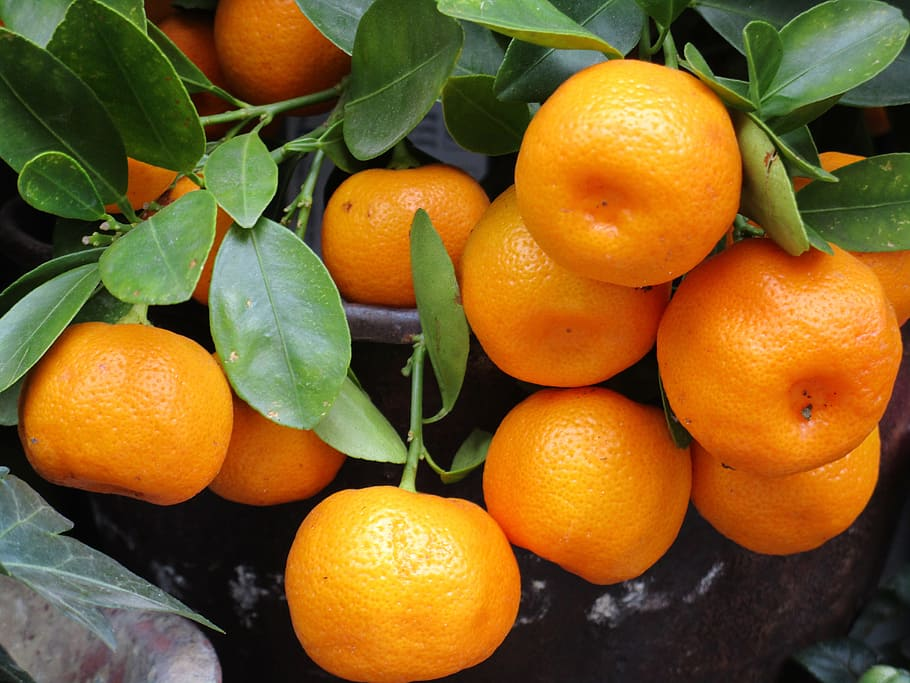

In [ ]:
cv2_imshow(image)              # Gambar Asli

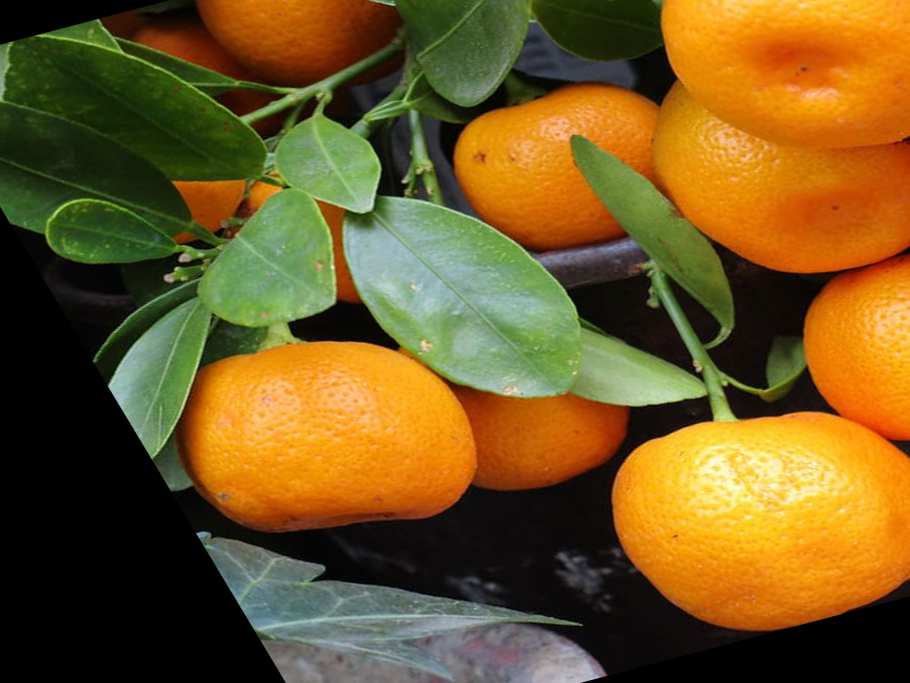

In [ ]:
cv2_imshow(affine_transformed) # Gambar setelah Afin

# Transformasi Perspektif

In [ ]:
# Menentukan empat titik sebelum dan sesudah transformasi
pts1 = np.float32([[56, 65], [368, 52], [28, 387], [389, 390]])
pts2 = np.float32([[0, 0], [300, 0], [0, 300], [300, 300]])

# Membuat matriks transformasi perspektif
M = cv2.getPerspectiveTransform(pts1, pts2)

# Menerapkan transformasi perspektif
perspective_transformed = cv2.warpPerspective(image, M, (300, 300))


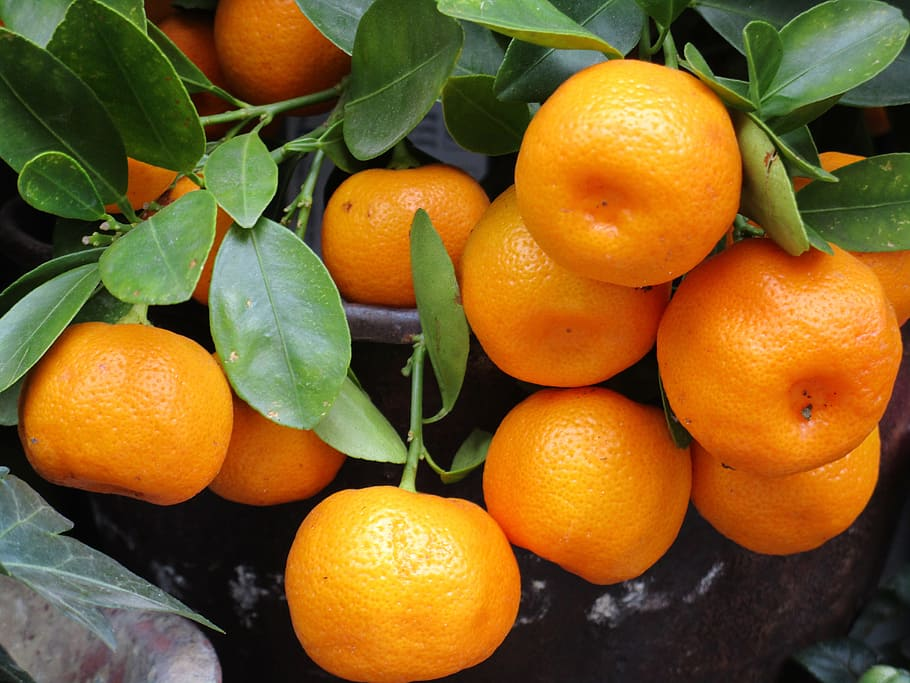

In [ ]:
cv2_imshow(image)                   # Gambar Asli

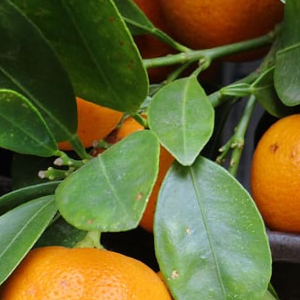

In [ ]:
cv2_imshow(perspective_transformed)  # Gambar setelah Perspektif